In [25]:
from genalog.generation.document import DocumentGenerator
from genalog.generation.content import CompositeContent, ContentType

# with open("C:/Users/joman/OneDrive - National University of Singapore/AImazing/OCR/x.txt", 'r') as f:
#     text = f.read()

# print(text[:1000])

In [26]:
import pandas as pd
data = pd.read_csv("C:/Users/joman/OneDrive - National University of Singapore/AImazing/OCR/data-1632291526069.csv")
data = data['raw_text']
# data

In [27]:
type(data[0])

str

In [28]:
# Initialize Content Object
paragraphs = data[0].split('\n\n\n\n\n')
content_types = [ContentType.PARAGRAPH] * len(paragraphs)
content = CompositeContent(paragraphs, content_types)

print(f"Object represention: {repr(content)}\n")
# you can also print the content object like a string
print(f"Transparent string: {content}"[:400])

Object represention: CompositeContent([<genalog.generation.content.Paragraph object at 0x0000026192E1EDF0>, <genalog.generation.content.Paragraph object at 0x0000026192E1EE50>, <genalog.generation.content.Paragraph object at 0x0000026192E1EA60>])

Transparent string: ["      BUFFALO FRANKIE INC.       
  Op. by: BUFFALO FRANKIE INC.   
CC 131 SM CITY NORTH EDSA COR NOR
TH AVE., BAGONG PAG-ASA QUEZON CI
               TY                
   VAT REG TIN.:009269227-001    
      SERIAL NO.:8CG92287N2      
    MIN NO.:19062511281642949    

BUYER'S INFORMATION:             
Name:______________________      
Address:______________________   
TIN


In [29]:
# Or iterate the content obj like an array
for paragraph in content:
    print(paragraph[:100])

      BUFFALO FRANKIE INC.       
  Op. by: BUFFALO FRANKIE INC.   
CC 131 SM CITY NORTH EDSA COR NO





,1610781398


In [30]:
# Initalize DocumentGenerator
# The default setting allow to use the built-in templates from the `genalog` package
default_generator = DocumentGenerator()

print(f"Available default templates: {default_generator.template_list}")
print(f"Default styles to generate: {default_generator.styles_to_generate}")

Available default templates: ['columns.html.jinja', 'letter.html.jinja', 'text_block.html.jinja']
Default styles to generate: [{'language': 'en_US', 'font_family': 'Segoe UI', 'font_size': '12px', 'text_align': 'left', 'hyphenate': False}]


{'language': 'en_US', 'font_family': 'Segoe UI', 'font_size': '12px', 'text_align': 'left', 'hyphenate': False}
text_block.html.jinja


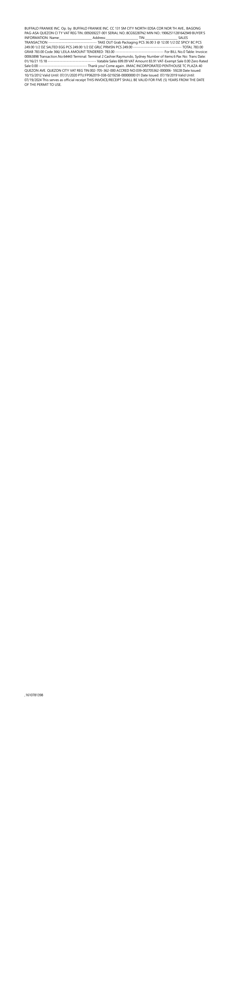

In [31]:
from IPython.core.display import Image, display

# Select specific template, content and create the generator
doc_gen = default_generator.create_generator(content, ['text_block.html.jinja']) 
# we will use the `content` object initialized from above 

for doc in doc_gen:
    print(doc.styles)
    print(doc.template.name)
    image_byte = doc.render_png(resolution=100)
    display(Image(image_byte))

In [32]:
# Load custom templates in local file path:
custom_document_generator = DocumentGenerator(template_path="../genalog/generation/templates")

print(custom_document_generator.template_list)

['base.css.jinja', 'base.html.jinja', 'columns.css.jinja', 'columns.html.jinja', 'letter.css.jinja', 'letter.html.jinja', 'macro/dimension.css.jinja', 'macro/page_layout.css.jinja', 'macro/text.css.jinja', 'text_block.css.jinja', 'text_block.html.jinja']


In [33]:
# # Create new content with titles and paragraphs
# sections = []
# section_content_types = []
# for index, p in enumerate(paragraphs):
#     sections.append(f"Section {index}:")
#     section_content_types.append(ContentType.TITLE)
#     sections.append(p)
#     section_content_types.append(ContentType.PARAGRAPH)

# titled_content = CompositeContent(sections, section_content_types)

# for c in titled_content:
#     print(c[:200])

In [34]:
# List the available tempaltes:
print(default_generator.template_list)

['columns.html.jinja', 'letter.html.jinja', 'text_block.html.jinja']


In [35]:
# Set new styles to generate
new_style_combinations = {
    "hyphenate": [True],
    "font_size": ["25px"],
    "font_family": ["Times"],
    "text_align": ["justify"]
}
default_generator.set_styles_to_generate(new_style_combinations)
print(f"Styles to generate: {default_generator.styles_to_generate}")

Styles to generate: [{'hyphenate': True, 'font_size': '25px', 'font_family': 'Times', 'text_align': 'justify'}]


In [36]:
# from IPython.core.display import Image, display
# doc_gen = default_generator.create_generator(titled_content, ["text_block.html.jinja", "letter.html.jinja"])

# for doc in doc_gen:
#     print(doc.styles)
#     print(doc.template.name)
#     # Save with different resolution
#     image_byte = doc.render_png(resolution=90)
#     display(Image(image_byte))

In [37]:
# Save as separate PNG files
doc_gen = default_generator.create_generator(content, ["text_block.html.jinja"])
default_generator.set_styles_to_generate(new_style_combinations)
# Configure image resolution in dots per inch (dpi)
resolution = 300
for doc in doc_gen:
    template_name = doc.template.name.replace(".html.jinja", "")
    png_name = "C:/Users/joman/OneDrive - National University of Singapore/AImazing/OCR/output/" + template_name + "_" + doc.styles["font_family"] + "_" + doc.styles["font_size"] + ".png"
    doc.render_png(target=png_name, split_pages=True, resolution=resolution)

In [38]:
png_name="C:/Users/joman/OneDrive - National University of Singapore/AImazing/OCR/output/text_block_Times_25px_pg_0.png"

## Image Generated, now going on to image degradation

In [39]:
import cv2
import numpy as np
import genalog.degradation.effect as effect
from matplotlib import pyplot as plt

# Configure plot sizes
# plt.rcParams['xtick.labelsize'] = 5
# plt.rcParams['ytick.labelsize'] = 5
%matplotlib inline

(3544, 2481) uint8


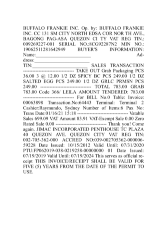

In [40]:
# Load in sample image
src = cv2.imread(png_name, cv2.IMREAD_GRAYSCALE)

# Note that the image is has ONE channel, and has `uint8` integer type with range [0,255]
print(src.shape, src.dtype)
plt.axis('off')
plt.imshow(src, cmap="gray")

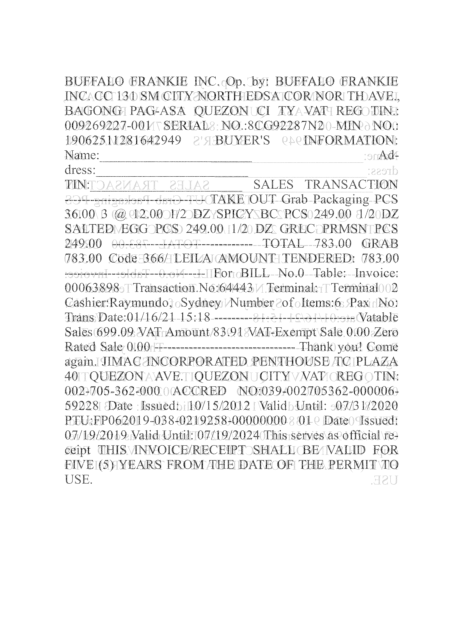

In [73]:
from genalog.degradation.degrader import Degrader

# We are applying degradation effects to the images in the following sequence:
# blur -> bleed_through -> salt
degradations = [
    ("blur", {"radius": 3}),
    ("bleed_through", {"alpha": 0.8}),
    ("salt", {"amount": 0.2}),
]
# All of the referenced degradation effects are in submodule `genalog.degradation.effect`

degrader = Degrader(degradations)
dst = degrader.apply_effects(src)
fig = plt.figure(figsize=(5, 4), dpi=200)
plt.axis('off')
plt.imshow(dst, cmap="gray")

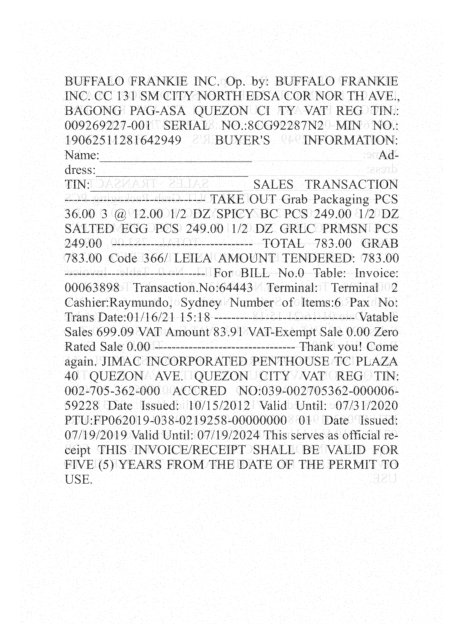

In [76]:
from genalog.degradation.degrader import Degrader, ImageState

degradations = [
    ("morphology", {"operation": "open", "kernel_shape":(9,9), "kernel_type":"plus"}),
    ("morphology", {"operation": "close", "kernel_shape":(9,1), "kernel_type":"ones"}),
    ("salt", {"amount": 0.7}),
    ("overlay", {
        "src": ImageState.ORIGINAL_STATE,
        "background": ImageState.CURRENT_STATE,
    }),
    ("bleed_through", {
        "src": ImageState.CURRENT_STATE,
        "background": ImageState.ORIGINAL_STATE,
        "alpha": 0.90,
        "offset_x": -5,
        "offset_y": -5,
    }),
    ("pepper", {"amount": 0.005}),
    ("blur", {"radius": 3}),
    ("salt", {"amount": 0.15}),
]

degrader = Degrader(degradations)
dst = degrader.apply_effects(src)
fig = plt.figure(figsize=(5, 4), dpi=200)
plt.axis('off')
plt.imshow(dst, cmap="gray")

In [41]:
from skimage.util.noise import random_noise
salted = effect.salt(src, amount=0.4) # amount is the percentage of pixels to be salted (whitened)
peppered = effect.pepper(src, amount=0.05) # amount is the percentage of pixels to be peppered (darkened)
salt_then_pepper = effect.salt_then_pepper(src, 0.4, 0.05)

# display input and output image
fig = plt.figure(figsize=(10,10), dpi=1500)
fig.add_subplot(2,2,1)
plt.axis('off')
plt.imshow(src, cmap="gray")
plt.title('src', fontsize=6)
fig.add_subplot(2,2,2)
plt.axis('off')
plt.imshow(salted, cmap="gray")
plt.title('salted', fontsize=6)
fig.add_subplot(2,2,3)
plt.axis('off')
plt.imshow(peppered, cmap="gray")
plt.title('peppered', fontsize=6)
fig.add_subplot(2,2,4)
plt.axis('off')
plt.imshow(salt_then_pepper, cmap="gray")
plt.title('salted then peppered', fontsize=6)
plt.show()

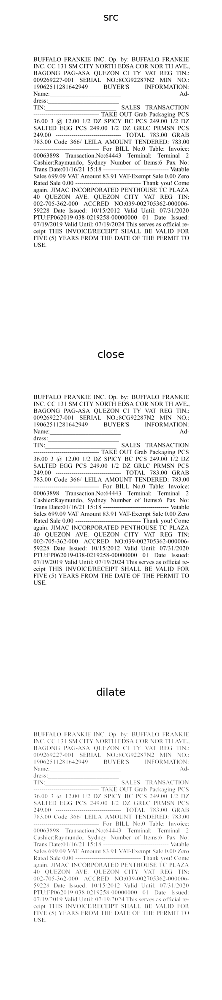

In [82]:
kernel = effect.create_2D_kernel((3,3), kernel_type="ones")
dilate = effect.dilate(src, kernel)
close = effect.close(src, kernel)# less destructive than dilation, given the same kernel

# display input and output image
fig = plt.figure(figsize=(10, 10), dpi=300)
fig.add_subplot(3,1,1)
plt.axis('off')
plt.imshow(src, cmap="gray")
plt.title('src', fontsize=6)
fig.add_subplot(3,1,2)
plt.axis('off')
plt.imshow(close, cmap="gray")
plt.title('close', fontsize=6)
fig.add_subplot(3,1,3)
plt.axis('off')
plt.imshow(dilate, cmap="gray")
plt.title('dilate', fontsize=6)
plt.show()

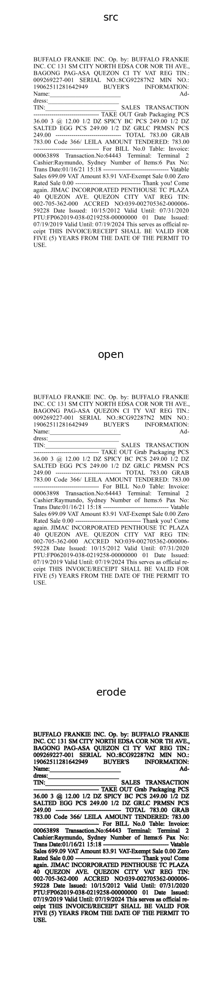

In [83]:
kernel = effect.create_2D_kernel((5,5), kernel_type="ones")
erode = effect.erode(src, kernel)
open = effect.open(src, kernel) # retains more of the foreground shape than erosion, given the same kernel

# display input and output image
fig = plt.figure(figsize=(10, 10), dpi=300)
fig.add_subplot(3,1,1)
plt.axis('off')
plt.imshow(src, cmap="gray")
plt.title('src', fontsize=6)
fig.add_subplot(3,1,2)
plt.axis('off')
plt.imshow(open, cmap="gray")
plt.title('open', fontsize=6)
fig.add_subplot(3,1,3)
plt.axis('off')
plt.imshow(erode, cmap="gray")
plt.title('erode', fontsize=6)
plt.show()

In [21]:
from genalog.generation.document import DocumentGenerator
from genalog.generation.content import CompositeContent, ContentType
import pandas as pd
from IPython.core.display import Image, display

In [19]:
def generate_image(input):
    paragraphs = input.split('\n\n\n\n\n')
    content_types = [ContentType.PARAGRAPH] * len(paragraphs)
    content = CompositeContent(paragraphs, content_types)
    print(f"Transparent string: {content}"[:400])

    default_generator = DocumentGenerator()
    doc_gen = default_generator.create_generator(content, ['text_block.html.jinja']) 
    #   we will use the `content` object initialized from above 

    for doc in doc_gen:
        print(doc.styles)
        print(doc.template.name)
        image_byte = doc.render_png(resolution=100)
        display(Image(image_byte))
    custom_document_generator = DocumentGenerator(template_path="../genalog/generation/templates")
    new_style_combinations = {
        "hyphenate": [True],
        "font_size": ["25px"],
        "font_family": ["Times"],
        "text_align": ["justify"]
    }
    default_generator.set_styles_to_generate(new_style_combinations)
    # print(f"Styles to generate: {default_generator.styles_to_generate}")
    doc_gen = default_generator.create_generator(content, ["text_block.html.jinja"])
    default_generator.set_styles_to_generate(new_style_combinations)
    # Configure image resolution in dots per inch (dpi)
    resolution = 300
    for doc in doc_gen:
        template_name = doc.template.name.replace(".html.jinja", "")
        png_name = "C:/Users/joman/OneDrive - National University of Singapore/AImazing/OCR/output/" + template_name + "_" + doc.styles["font_family"] + "_" + doc.styles["font_size"] + ".png"
        doc.render_png(target=png_name, split_pages=True, resolution=resolution)

In [8]:
test=data[0]
type(test)

str

Transparent string: ["      BUFFALO FRANKIE INC.       
  Op. by: BUFFALO FRANKIE INC.   
CC 131 SM CITY NORTH EDSA COR NOR
TH AVE., BAGONG PAG-ASA QUEZON CI
               TY                
   VAT REG TIN.:009269227-001    
      SERIAL NO.:8CG92287N2      
    MIN NO.:19062511281642949    

BUYER'S INFORMATION:             
Name:______________________      
Address:______________________   
TIN
{'language': 'en_US', 'font_family': 'Segoe UI', 'font_size': '12px', 'text_align': 'left', 'hyphenate': False}
text_block.html.jinja


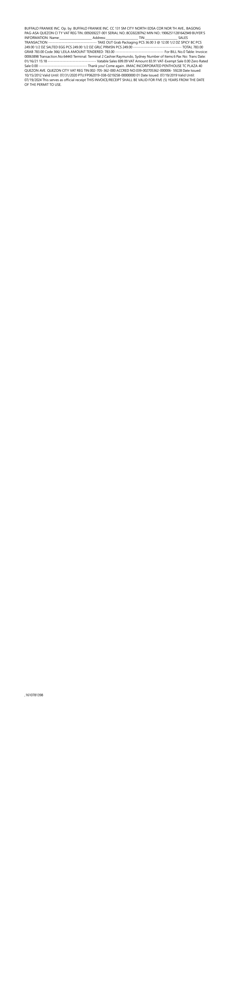

In [22]:
generate_image(test)

In [55]:
import cv2
import numpy as np
import genalog.degradation.effect as effect
from matplotlib import pyplot as plt
%matplotlib inline

from genalog.degradation.degrader import Degrader
from genalog.degradation.degrader import Degrader, ImageState


In [51]:
from skimage.util.noise import random_noise
def image_degradation_sp(image): #salted and peppered
    salt_then_pepper = effect.salt_then_pepper(src, 0.4, 0.05)
    plt.axis('off')
    plt.imshow(salt_then_pepper, cmap="gray")
    plt.title('salted then peppered', fontsize=6)
    plt.savefig("C:/Users/joman/OneDrive - National University of Singapore/AImazing/OCR/output/foo.png")
    plt.show()


In [57]:
def image_degradation_erode(image): 
    kernel = effect.create_2D_kernel((5,5), kernel_type="ones")
    erode = effect.erode(src, kernel)
    plt.axis('off')
    plt.imshow(erode, cmap="gray")
    plt.show()
    plt.savefig("C:/Users/joman/OneDrive - National University of Singapore/AImazing/OCR/output/foo.png")
    plt.show()

In [61]:
def image_degradation_dilate(image): 
    kernel = effect.create_2D_kernel((3,3), kernel_type="ones")
    dilate = effect.dilate(src, kernel)
    plt.axis('off')
    plt.imshow(dilate, cmap="gray")
    plt.show()
    plt.savefig("C:/Users/joman/OneDrive - National University of Singapore/AImazing/OCR/output/foo.png")


(3544, 2481) uint8


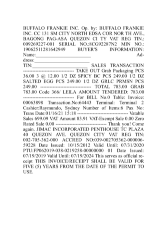

In [43]:
png_name="C:/Users/joman/OneDrive - National University of Singapore/AImazing/OCR/output/text_block_Times_25px_pg_0.png"
# Load in sample image
src = cv2.imread(png_name, cv2.IMREAD_GRAYSCALE)

# Note that the image is has ONE channel, and has `uint8` integer type with range [0,255]
print(src.shape, src.dtype)
plt.axis('off')
plt.imshow(src, cmap="gray")

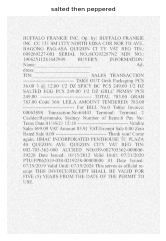

In [52]:
image_degradation_sp(src)

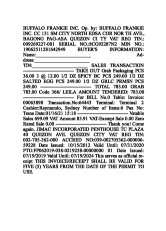

<Figure size 432x288 with 0 Axes>

In [58]:
image_degradation_erode(src)

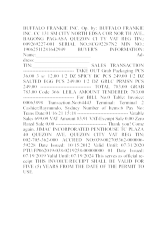

<Figure size 432x288 with 0 Axes>

In [62]:
image_degradation_dilate(src)